In [4]:
import pandas as pd
import numpy as np
data_folder = "../data/"


In [5]:
def read_data(csv_name):
    data = pd.read_csv(data_folder + csv_name)
    values, labels = data.drop(columns=['label']), data.label
    return values.values, labels.values


In [6]:
spam_values, spam_labels = read_data("spam.csv")
cancer_values, cancer_labels = read_data("cancer.csv")


In [109]:
# get k nearest for point exclude itself
def get_k_nearest(k, points, idx):
    current_point = points[idx]
    distances_to_current_point = []
    for point in points:
        distances_to_current_point.append(np.linalg.norm(current_point - point))
    sorted_neighbours = np.argsort(np.array(distances_to_current_point))
    return sorted_neighbours.tolist()[1:k + 1]

def knn_for_all_points(k, points):
    knn_matrix = []
    for idx in range(points.shape[0]):
        knn_matrix.append(get_k_nearest(k, points, idx))
    return knn_matrix

def classify_point(knn_matrix, labels, k, idx):
    classes, counts = np.unique(labels[knn_matrix[idx]][:k], return_counts=True)
    return classes[np.argmax(counts)]

def loo(knn_matrix, labels, k):
    n = len(labels)
    sum_labels = 0
    for idx in range(n):
        if classify_point(knn_matrix, labels, k, idx) != labels[idx]:
            sum_labels += 1.0
    return sum_labels / n
    
def loo_k(values, labels, k):
    knn_matrix = knn_for_all_points(k, values)
    loo_errors = []
    for idx in range(1, k + 1):
        loo_errors.append(loo(knn_matrix, labels, idx))
    return loo_errors 


In [110]:
def task1_result_cancer():
    print("cancer")
    cancer_loo = loo_k(cancer_values, cancer_labels, 10)
    for k, error in enumerate(cancer_loo):
        print("k = " + str(k + 1) + "; loo = " + str(error))
        
task1_result_cancer()


cancer
k = 1; loo = 0.0843585237258348
k = 2; loo = 0.0773286467486819
k = 3; loo = 0.07381370826010544
k = 4; loo = 0.07381370826010544
k = 5; loo = 0.06678383128295255
k = 6; loo = 0.070298769771529
k = 7; loo = 0.06854130052724078
k = 8; loo = 0.070298769771529
k = 9; loo = 0.06678383128295255
k = 10; loo = 0.070298769771529


In [133]:
def task1_result_spam():
    print("spam")
    spam_loo = loo_k(spam_values, spam_labels, 10)
    for k, error in enumerate(spam_loo):
        print("k = " + str(k + 1) + "; loo = " + str(error))
        
task1_result_spam()


spam
k = 1; loo = 0.16865898717670072
k = 2; loo = 0.19039339274070854
k = 3; loo = 0.18452510323842644
k = 4; loo = 0.19213214518582916
k = 5; loo = 0.18539447946098675
k = 6; loo = 0.199956531188872
k = 7; loo = 0.1958269941317105
k = 8; loo = 0.2010432514670724
k = 9; loo = 0.20256465985655292
k = 10; loo = 0.2019126276896327


In [146]:
def scale(features):
    return (features - features.min(axis=0)) / (features.max(axis=0) - features.min(axis=0))


In [147]:
def task2_result_cancer():
    print("scaled_cancer")
    scaled_cancer_values = scale(cancer_values)
    cancer_loo = loo_k(scaled_cancer_values, cancer_labels, 10)
    for k, error in enumerate(cancer_loo):
        print("k = " + str(k + 1) + "; loo = " + str(error))
        
task2_result_cancer()


scaled_cancer
k = 1; loo = 0.04745166959578207
k = 2; loo = 0.03866432337434095
k = 3; loo = 0.029876977152899824
k = 4; loo = 0.028119507908611598
k = 5; loo = 0.033391915641476276
k = 6; loo = 0.029876977152899824
k = 7; loo = 0.029876977152899824
k = 8; loo = 0.03163444639718805
k = 9; loo = 0.029876977152899824
k = 10; loo = 0.029876977152899824


In [148]:
def task2_result_spam():
    print("scaled_spam")
    scaled_spam_values = scale(spam_values)
    spam_loo = loo_k(scaled_spam_values, spam_labels, 10)
    for k, error in enumerate(spam_loo):
        print("k = " + str(k + 1) + "; loo = " + str(error))
        
task2_result_spam()


scaled_spam
k = 1; loo = 0.0869376222560313
k = 2; loo = 0.10106498587263639
k = 3; loo = 0.09497935231471419
k = 4; loo = 0.10149967398391654
k = 5; loo = 0.09497935231471419
k = 6; loo = 0.10258639426211694
k = 7; loo = 0.09932623342751576
k = 8; loo = 0.10215170615083677
k = 9; loo = 0.1019343620951967
k = 10; loo = 0.10519452292979788


In [2]:
blobs = pd.read_csv(data_folder + "blobs.csv").values


In [119]:
import random

def generate_initial_centers(values, count_of_centers):
    return random.sample(list(values), count_of_centers)

def k_means(values, k):
    centers = generate_initial_centers(values, k)
    n = len(values)
    
    while True:
        clusters_of_points = []
        
        for value in values:
            best_index = 0
            for center_index in range(k):
                if np.linalg.norm(value - centers[best_index]) > np.linalg.norm(value - centers[center_index]):
                    best_index = center_index
            clusters_of_points.append(best_index)
        
        cnt = np.zeros(n)
        old_centers = np.copy(centers)
        
        for i in range(k):
            centers[i] = np.array([0] * values.shape[1])
            
        for i in range(n):
            centers[clusters_of_points[i]] = np.array(centers[clusters_of_points[i]]) + values[i]
            cnt[clusters_of_points[i]] += 1
        
        for i in range(k):
            if cnt[i] != 0:
                centers[i] /= cnt[i]
            
        if np.allclose(old_centers, centers):
            break
        
    return np.array(clusters_of_points)


In [8]:
import matplotlib.pyplot as plt

def draw(values, clusters):
    c = ['black', 'red', 'green', 'blue', 'yellow', 'cyan']
    x = [row[0] for row in values]
    y = [row[1] for row in values]
    color = [c[i % 6] for i in clusters]
    
    plt.scatter(x, y, c=color)
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.show()


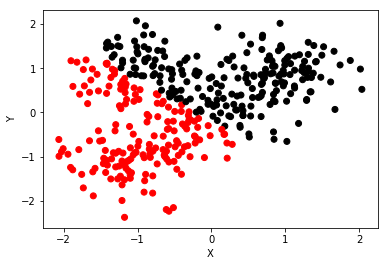

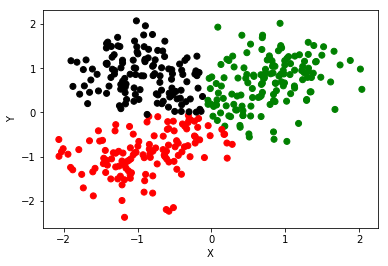

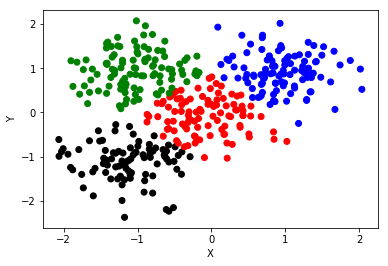

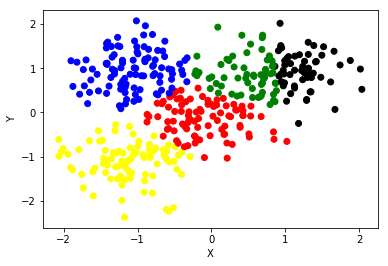

In [41]:
def task3():
    for k in range(2, 6):
        clusters = k_means(blobs, k)
        draw(blobs, clusters)
        
task3()


In [43]:
def eps_neighbours(values, eps, point_idx):
    neighbors = []
    for i in range(len(values)):
        if point_idx != i and np.linalg.norm(values[point_idx] - values[i]) < eps:
            neighbors.append(i)
    return neighbors

def dbscan(values, m, eps):
    c = 0
    clusters = np.zeros(len(values), dtype=int)
    
    for i in range(len(values)):
        if clusters[i] != 0:
            continue
            
        neighbors = eps_neighbours(values, eps, i)

        if len(neighbors) < m:
            continue
        
        c += 1
        clusters[i] = c
        
        while True:
            nxt = []
            
            for j in neighbors:
                if clusters[j] != 0:
                    continue
                
                clusters[j] = c
                current = eps_neighbours(values, eps, j)
        
                if len(current) >= m:
                    nxt.extend(current)
 
            if len(nxt) == 0:
                break
                
            neighbors = np.copy(nxt)
        
    return np.array(clusters)


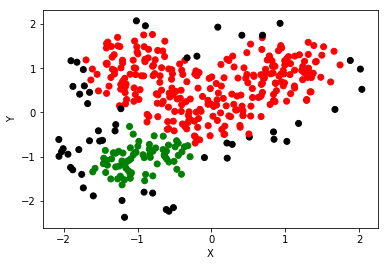

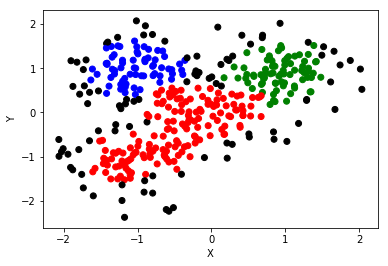

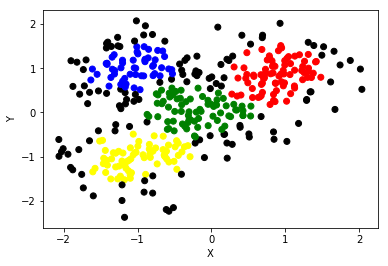

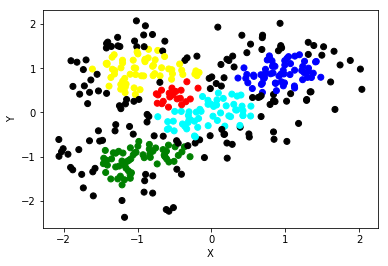

In [88]:
def task4():
    clusterizations = [dbscan(blobs, 40, 0.5), dbscan(blobs, 23, 0.36), dbscan(blobs, 23, 0.35), dbscan(blobs, 11, 0.24)]
    for partition in clusterizations:
        draw(blobs, partition)
    
task4()


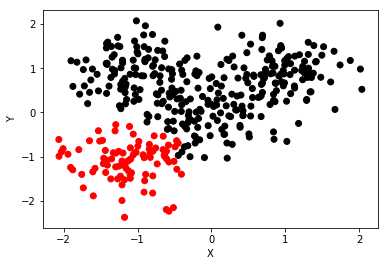

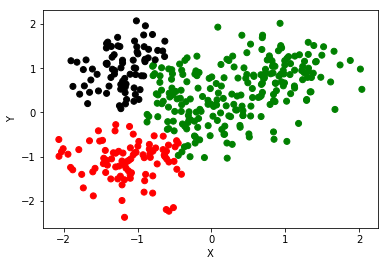

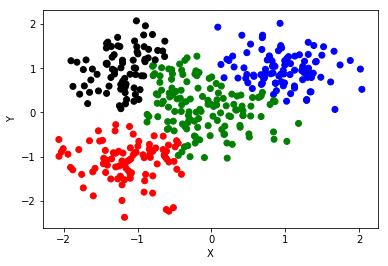

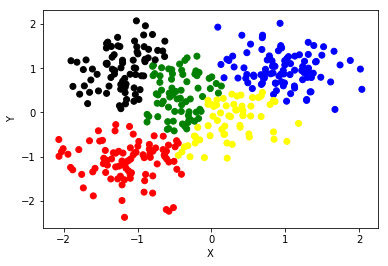

In [25]:
from scipy.spatial import distance_matrix

#returns two clusters with minimal distance between them
# distance(c1, c2) = max(dist(point_from_c1, point_from_c2))
def find_closest_clusters(dist, clusters, max_dist):
    closest_clusters_indices = (0, 1)
    min_dist = max_dist
    n = len(clusters)
    for i in range(n):
        for j in range(i + 1, n):
            distance_between_clusters = max([dist[c1, c2] for c1 in clusters[i] for c2 in clusters[j]])
                
            if distance_between_clusters < min_dist:
                min_dist = distance_between_clusters
                closest_clusters_indices = (i, j)
                
    return closest_clusters_indices

def agglomerative_clustering(values, k):
    dist = distance_matrix(values, values)
    max_distance = dist.max()
    clusters = list([[i] for i in range(len(values))])
    
    while len(clusters) > k:
        c1, c2 = find_closest_clusters(dist, clusters, max_distance)
        clusters[c1] += clusters[c2]
        del clusters[c2]
        
    predict = np.zeros(len(values), dtype=int)
    for i in range(len(clusters)):
        for j in clusters[i]:
            predict[j] = i
            
    return predict

def task5():
    for k in range(2, 6):
        clusters = agglomerative_clustering(blobs, k)
        draw(blobs, clusters)
        
task5()

In [125]:
from sklearn import metrics

def purity(labels, clusters):
    contingency_matrix = metrics.cluster.contingency_matrix(labels, clusters)
    return np.sum(np.amax(contingency_matrix, axis=0)) / np.sum(contingency_matrix)


In [126]:
def task6():
    for k in [2, 3, 5, 10]:
        clusters = k_means(cancer_values, k)
        print(purity(cancer_labels, clusters))
        
task6()


0.8541300527240774
0.8875219683655536
0.8910369068541301
0.9103690685413005


In [35]:
from sklearn import metrics

def roc_curves(values, labels):
    scores = [metrics.roc_auc_score(labels, values[:,i]) for i in range(values.shape[1])]
    best = np.argsort(scores)[-3:]
    
    return [metrics.roc_curve(labels, values[:,i], pos_label=1.0) for i in best]

def plot_curve(curve):
    plt.xlabel("FP")
    plt.ylabel("TP")
    plt.plot(curve[0], curve[1])
    plt.plot([0, 1], [0, 1])
    plt.show()


In [40]:
def task7_spam(): 
    curves = roc_curves(spam_values, spam_labels)
    for curve in curves:
        plot_curve(curve)

def task7_cancer():
    # pos_label='M' not working for me
    mapped_labels = list(map(lambda label: 1 if label == 'M' else 0, cancer_labels))
    curves = roc_curves(cancer_values, mapped_labels)
    for curve in curves:
        plot_curve(curve)


spam


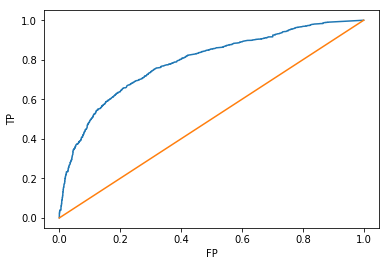

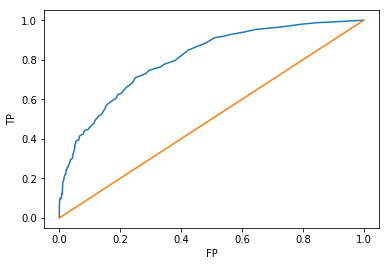

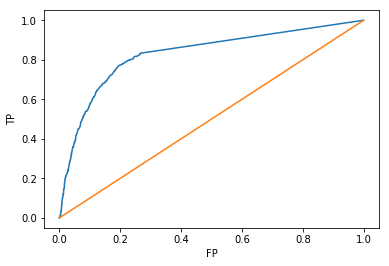

In [41]:
print("spam")
task7_spam()


cancer


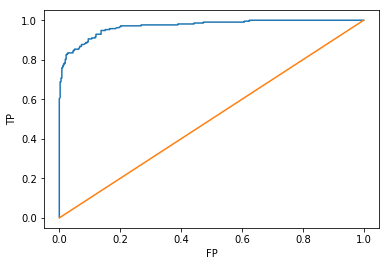

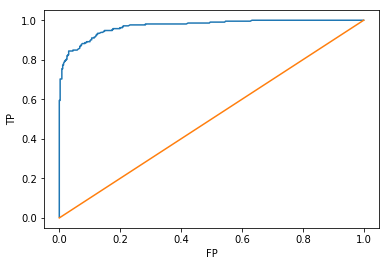

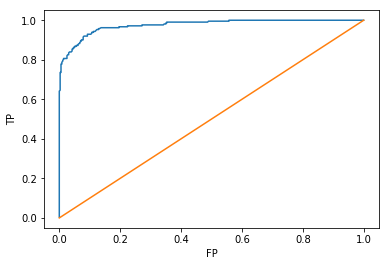

In [42]:
print("cancer")
task7_cancer()


In [7]:
from sklearn.model_selection import train_test_split
from collections import defaultdict

def split_dataset(values, labels):
    values_train, values_test, labels_train, labels_test = train_test_split(values, labels, train_size=0.8)  
    return values_train, values_test, labels_train, labels_test

def proportions(labels):
    counters = defaultdict(float)
    for label in labels:
        counters[label] += 1
    return {k: v / len(labels) for k, v in counters.items()}


In [57]:
def task8_cancer():
    values_train, values_test, labels_train, labels_test = split_dataset(cancer_values, cancer_labels)
    print("cancer train proportions")
    print(proportions(labels_train))
    print("cancer test proportions")
    print(proportions(labels_test))

def task8_spam():
    values_train, values_test, labels_train, labels_test = split_dataset(spam_values, spam_labels)
    print("spam train proportions")
    print(proportions(labels_train))
    print("spam test proportions")
    print(proportions(labels_test))


In [62]:
task8_cancer()


cancer train proportions
{'B': 0.6285714285714286, 'M': 0.37142857142857144}
cancer test proportions
{'B': 0.6228070175438597, 'M': 0.37719298245614036}


F:\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:2026: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


In [64]:
task8_spam()


spam train proportions
{0: 0.6057065217391304, 1: 0.3942934782608696}
spam test proportions
{0: 0.6069489685124865, 1: 0.3930510314875136}


F:\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:2026: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


In [67]:
arr = np.array([1, 2, 3, 5])
mask = np.array([True, False, True, False])

print(arr[mask])

[1 3]


In [20]:
def gini_impurity(masks, y):
    print(masks)
    print(y)
    n_instances = y.shape[0]
    gini = 0.0
    for mask in masks:
        size = np.sum(mask)
        if size == 0:
            continue
        classes, counts = np.unique(y[mask], return_counts=True)
        score = np.sum(counts ** 2) / size ** 2
        gini += (1.0 - score) * (size / n_instances)
    return gini

"""def get_proba_classes(points_mask, y, y_original):
    classes, counts = np.unique(y[points_mask], return_counts=True)
    classes_all = np.unique(y_original)
    sorted_args = np.argsort(classes) 
    res_inter = np.array(counts[sorted_args] / np.sum(counts))
    sorted_args_all = np.argsort(classes_all)
    k = 0
    res = np.zeros(classes_all.shape[0])
    for i in range(sorted_args_all.shape[0]):
        if k < classes.shape[0] and classes[k] == classes_all[i]:
            res[i] = res_inter[k]
            k += 1
    return res"""
    
class Node:
    def __init__(self, depth, left=None, right=None, feature_index=None, value=None, proba=None):
        self.left = left
        self.right = right
        self.feature_index = feature_index
        self.value = value
        self.depth = depth
        #self.proba = proba
    
    """def predict_proba(self, mask, X):
        if not np.any(mask):
            return None
        if self.proba is not None:
            return np.array([self.proba,]*np.sum(mask))
        l_mask = X[mask, self.feature_index] < self.value
        l = self.left.predict_proba(l_mask, X[mask])
        r_mask = X[mask, self.feature_index] >= self.value
        r = self.right.predict_proba(r_mask, X[mask])
        if l is None:
            assert(r is not None)
            return r
        elif r is None:
            assert(l is not None)
            return l
        else:
            res = np.zeros((l.shape[0] + r.shape[0], l.shape[1]))
            res[l_mask] = l
            res[r_mask] = r
            return res"""
        
class my_tree_classifier:
    def __init__(self, max_depth):
        self.max_depth = max_depth

    def fit(self, X, y):
        self.root = Node(depth=0)
        self.y_original = y
        self.split(self.root, np.ones(X.shape[0], dtype=bool), X, y)
    
    def split(self, node, points_mask, X, y):
        print("split start")
        if np.unique(y[points_mask]).shape[0] == 1 or node.depth == self.max_depth:
            #node.proba = get_proba_classes(points_mask, y, self.y_original)
            return
        
        arr_shape = (np.sum(points_mask), X.shape[1])
        print(arr_shape)
        gini_impurities = np.ones(arr_shape)
        return_values = np.empty(arr_shape, dtype=object)
        true_args = np.argwhere(points_mask==True).reshape(1, -1)[0]
        for i in range(arr_shape[0]):
            for feature_id in range(arr_shape[1]):
                value = X[true_args[i]][feature_id]
                left_mask = X[points_mask, feature_id] < value
                right_mask = X[points_mask, feature_id] >= value
                gini_impurities[i][feature_id] = gini_impurity([left_mask, right_mask], y[points_mask])
                return_values[i][feature_id] = (feature_id, value, left_mask, right_mask)
                
        node.feature_index, node.value, left_mask, right_mask = return_values[np.unravel_index(np.argmin(gini_impurities, axis=None), gini_impurities.shape)]
        
        
        node.left = Node(depth=node.depth + 1)
        node.right = Node(depth=node.depth + 1)
        self.split(node.left, left_mask, X[points_mask], y[points_mask])
        self.split(node.right, right_mask, X[points_mask], y[points_mask])
    
    #def predict(self, X):
        #return np.argmax(self.predict_proba(X), axis=1)
        
    #def predict_proba(self, X):
        #return self.root.predict_proba(np.ones(X.shape[0], dtype=bool), X)


In [21]:
depth_range = range(1,2)
my_depth_clfs = [my_tree_classifier(max_depth=d) for d in depth_range]

In [ ]:
# cancer
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import accuracy_score
values_train, values_test, labels_train, labels_test = split_dataset(spam_values, spam_labels)
print("Spam case")
print("xxx")
best_acc = -1
accuracies = np.zeros(len(my_depth_clfs))
aucs = np.zeros(len(my_depth_clfs))
for i, clf in enumerate(my_depth_clfs):
    clf.fit(values_train, labels_train)
    #pred = clf.predict(values_test)
    #accuracies[i] = accuracy_score(labels_test, pred)
    
    #pred_proba = clf.predict_proba(values_test)
    #aucs[i] = roc_auc_score(labels_test, pred_proba[:, 1])
    
    #print("clf = " + str(i) + " with acc = " + str(accuracies[i]) + " and auc = " + str(aucs[i]))
"""best_clf_index_acc = np.argmax(accuracies)
print('Best in terms of accuracy is depth = ' + str(best_clf_index_acc + 1) + ' with accuracy = ' + str(np.max(accuracies)))
best_clf_index_auc = np.argmax(aucs)
print('Best in terms of aucs is depth = ' + str(best_clf_index_auc + 1) + ' with auc = ' + str(np.max(aucs)))"""

F:\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:2026: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


Spam case
xxx
split start
(3680, 57)
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False, False]), array([ True,  True,  True, ...,  True,  True,  True])]
[0 1 0 ... 0 1 0]
[array([False,  True,  True, ...,  True,  True,  True]), array([ True, False, False, ..., False, False, False])]
[0 1 0 ... 0 1 0]
[array([False, False, False, ..., False, False